Estimado candidato,

Estamos encantados de que estés considerando unirte a nuestro equipo de ciencia de datos. Como parte de nuestro proceso de evaluación, te pedimos que completes la siguiente prueba técnica.

**Descripción de la tarea:**

Se te proporciona un conjunto de datos anónimos que consta de varias columnas nombradas como 'col1', 'col2', 'col3', etc., hasta 'col20', y una columna 'target' que representa la variable objetivo. Tu tarea es realizar un análisis exploratorio de datos (EDA) y construir un modelo de aprendizaje automático para predecir la variable 'target'.

**Detalles de la tarea:**

1. **Análisis exploratorio de datos (EDA):** Realiza un análisis exploratorio detallado de los datos. Esto debe incluir, pero no está limitado a:
   - Estadísticas descriptivas de las variables (mínimo, máximo, media, mediana, desviación estándar, etc.).
   - Verificación de valores perdidos o anómalos.
   - Análisis de correlación entre las variables.
   - Visualizaciones para entender mejor las distribuciones y relaciones de los datos.

2. **Preprocesamiento de datos:** Prepárate para realizar cualquier limpieza o transformación necesaria de los datos basándote en tu EDA.

3. **Creación de un modelo de línea base (Baseline):** Entrena varios modelos de aprendizaje automático para predecir la variable 'target'. Comienza con modelos sencillos como la regresión logística y avanza hacia modelos más complejos como los árboles de decisión, random forest, SVM, XGBoost, etc.

4. **Evaluación del modelo:** Evalúa el rendimiento de cada modelo utilizando métricas apropiadas. Por ejemplo, si 'target' es una variable binaria, podrías considerar la precisión, la sensibilidad, la especificidad, el AUC-ROC, etc.

5. **Selección del modelo:** Selecciona el modelo que creas que funciona mejor. Justifica tu elección basándote en las métricas de evaluación y cualquier otra consideración pertinente.

6. **Predicción:** Usa tu modelo seleccionado para hacer predicciones en el conjunto de datos.

**Entregables:**

Por favor, proporciona el código que hayas utilizado para completar esta tarea, junto con un informe detallado que explique tu enfoque y los resultados. El informe debe estar bien estructurado y ser fácil de seguir, permitiendo a los evaluadores entender tu proceso de pensamiento y las decisiones que hayas tomado.

¡Buena suerte y esperamos ver tu solución!

# 1. Obtención y análisis exploratorio de los datos  
  
Se importan todas las librerías necesarias. Además, se descargan los datasets en dos variables, una para el dataset train (**df_train**) y otra para el dataset test (**df_test**). Además se realiza la observación del dataset y un primer análisis rápido de cada uno.  


In [57]:
# Importación de librerías
import pandas as pd
import numpy as np
import utils.Functions as fn
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV

## 1.2 Train

In [41]:
df_train = pd.read_csv('data/train.csv', index_col=0)
df_train.head()

,col1,col2,col3,col4,col5,col6,col7,col8,col9,col10,...,col12,col13,col14,col15,col16,col17,col18,col19,col20,target
ID,,,,,,,,,,,,,,,,,,,,,
4995,0.02,26.80,0.09,1.35,0.060,0.09,0.09,1.97,1.48,0.00,...,0.031,9.52,0.84,0.001,1.24,0.96,0.09,0.08,0.08,0
1709,1.13,3.95,0.32,3.95,0.030,4.66,0.56,1.89,1.36,0.82,...,0.170,13.83,1.15,0.006,10.55,3.76,0.02,0.45,0.06,0
7825,0.07,8.05,0.04,0.14,0.040,0.06,0.06,0.05,0.00,0.00,...,0.120,2.61,1.52,0.008,4.13,0.27,0.03,0.03,0.01,0
6918,0.09,26.40,0.03,0.92,0.090,0.57,0.00,0.36,0.03,0.23,...,0.055,5.22,1.96,0.000,11.32,0.25,0.09,0.01,0.05,0
5,0.94,14.47,0.03,2.88,0.003,0.80,0.43,1.38,0.11,0.67,...,0.135,9.75,1.89,0.006,27.17,5.42,0.08,0.19,0.02,1


In [3]:
# Primera visión de los datos
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5597 entries, 4995 to 3294
Data columns (total 21 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   col1    5597 non-null   float64
 1   col2    5597 non-null   float64
 2   col3    5597 non-null   float64
 3   col4    5597 non-null   float64
 4   col5    5597 non-null   float64
 5   col6    5597 non-null   float64
 6   col7    5597 non-null   float64
 7   col8    5597 non-null   float64
 8   col9    5597 non-null   float64
 9   col10   5597 non-null   float64
 10  col11   5597 non-null   float64
 11  col12   5597 non-null   float64
 12  col13   5597 non-null   float64
 13  col14   5597 non-null   float64
 14  col15   5597 non-null   float64
 15  col16   5597 non-null   float64
 16  col17   5597 non-null   float64
 17  col18   5597 non-null   float64
 18  col19   5597 non-null   float64
 19  col20   5597 non-null   float64
 20  target  5597 non-null   int64  
dtypes: float64(20), int64(1)
memory us

In [4]:
# Primera descripción de los datos
df_train.describe()

,col1,col2,col3,col4,col5,col6,col7,col8,col9,col10,...,col12,col13,col14,col15,col16,col17,col18,col19,col20,target
count,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,...,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000
mean,0.674797,14.438840,0.163603,1.579702,0.042747,2.213093,0.250890,0.807654,0.766057,0.324309,...,0.100050,9.819267,1.331880,0.005194,16.621249,2.931896,0.049602,0.149855,0.044999,0.114347
std,1.273677,8.851097,0.254659,1.221220,0.036072,2.581244,0.272472,0.652471,0.436435,0.328954,...,0.057997,5.581795,0.568734,0.002960,17.729833,2.327347,0.028827,0.144170,0.026929,0.318261
min,0.000000,-0.080000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.001000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.040000,6.850000,0.030000,0.550000,0.008000,0.100000,0.050000,0.090000,0.400000,0.000000,...,0.049000,4.940000,1.010000,0.003000,2.220000,0.820000,0.020000,0.040000,0.020000,0.000000
50%,0.070000,14.390000,0.050000,1.210000,0.040000,0.550000,0.090000,0.750000,0.760000,0.230000,...,0.103000,9.860000,1.420000,0.005000,7.840000,2.430000,0.050000,0.080000,0.050000,0.000000
75%,0.290000,22.260000,0.100000,2.510000,0.070000,4.330000,0.450000,1.390000,1.160000,0.610000,...,0.151000,14.690000,1.760000,0.008000,29.980000,4.670000,0.070000,0.250000,0.070000,0.000000
max,5.050000,29.840000,1.050000,4.940000,0.130000,8.660000,0.900000,2.000000,1.500000,1.000000,...,0.200000,19.820000,2.890000,0.010000,60.010000,7.990000,0.100000,0.500000,0.090000,1.000000


Análisis univariante de col1:


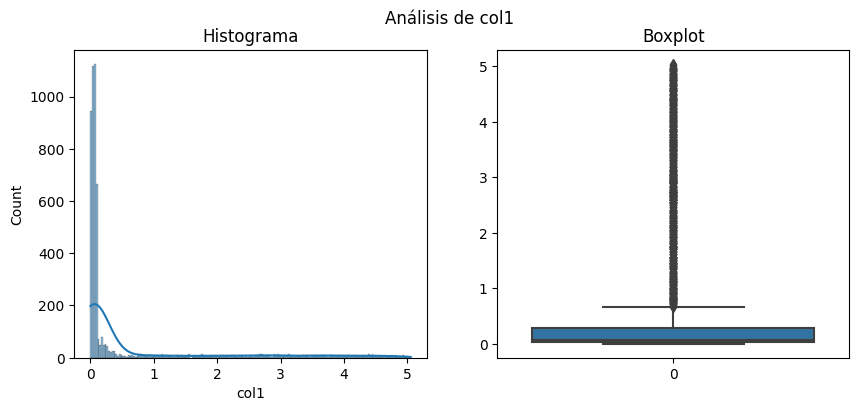

La columna col1 no presenta una distribución normal



Análisis univariante de col2:


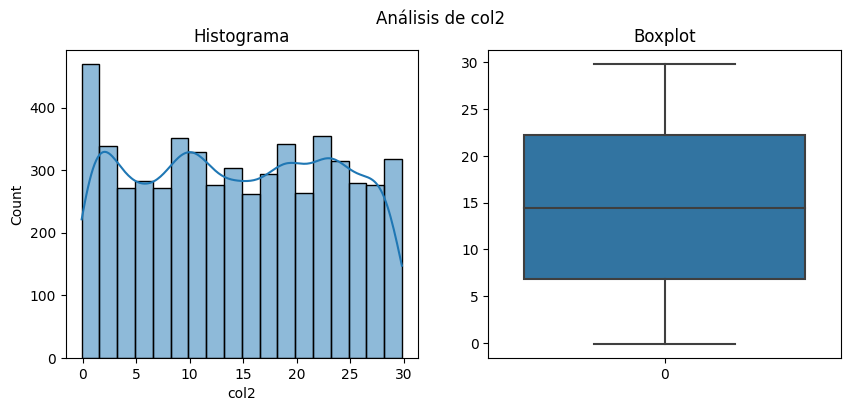

La columna col2 no presenta una distribución normal



Análisis univariante de col3:


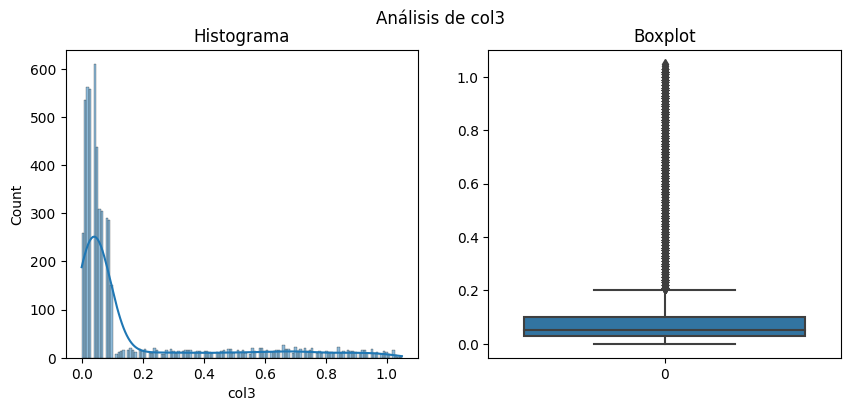

La columna col3 no presenta una distribución normal



Análisis univariante de col4:


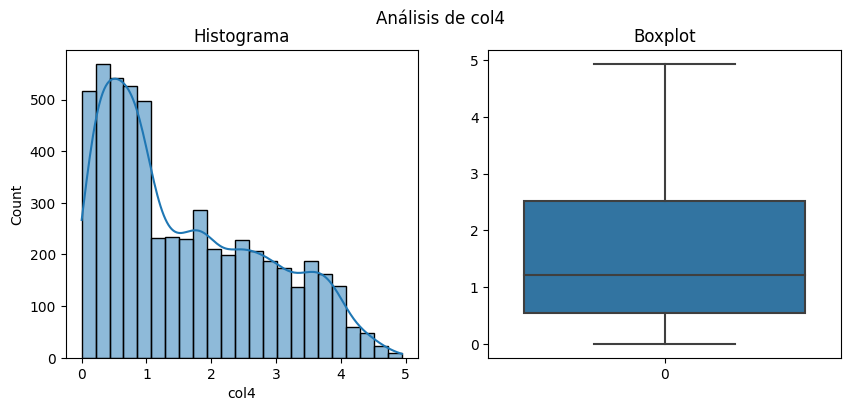

La columna col4 no presenta una distribución normal



Análisis univariante de col5:


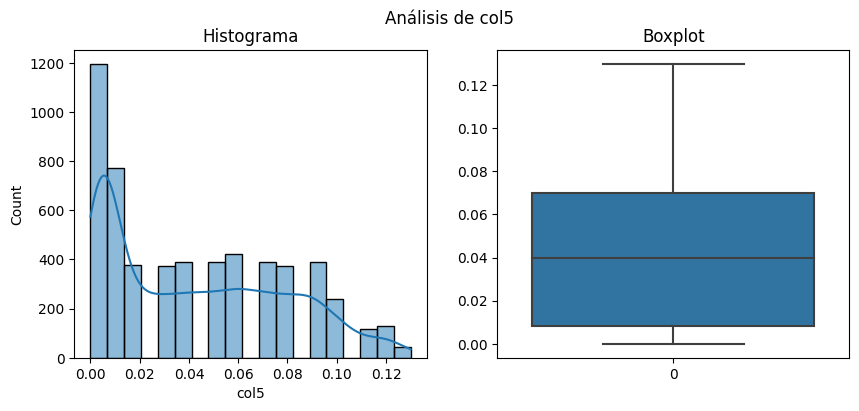

La columna col5 no presenta una distribución normal



Análisis univariante de col6:


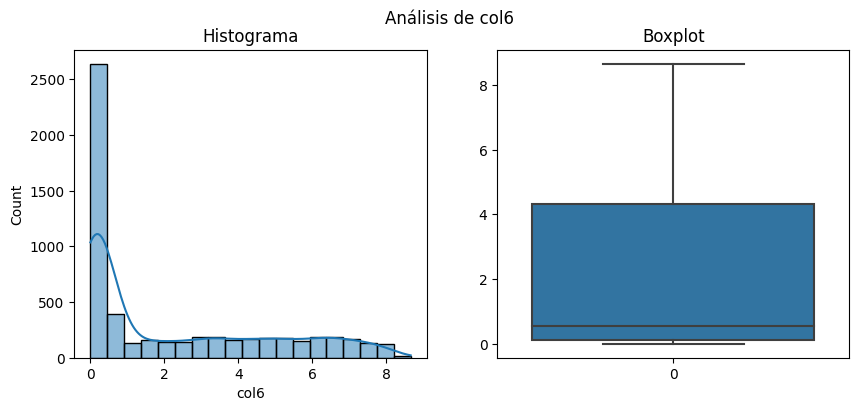

La columna col6 no presenta una distribución normal



Análisis univariante de col7:


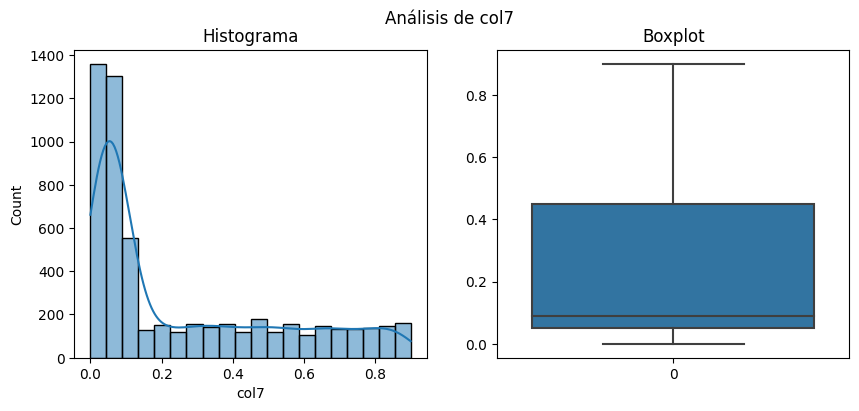

La columna col7 no presenta una distribución normal



Análisis univariante de col8:


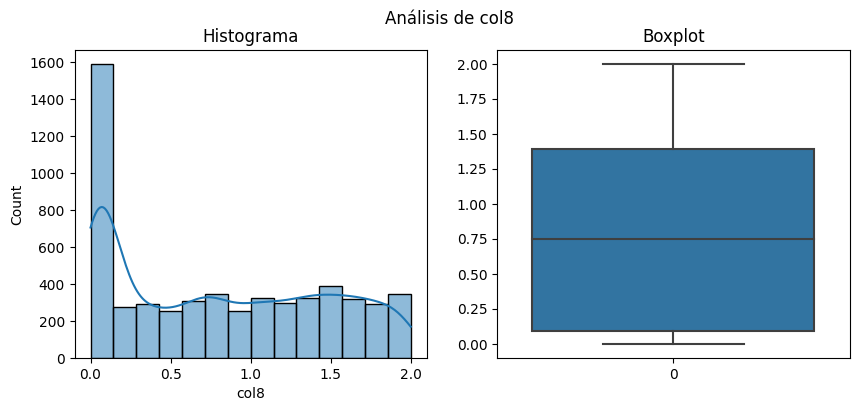

La columna col8 no presenta una distribución normal



Análisis univariante de col9:


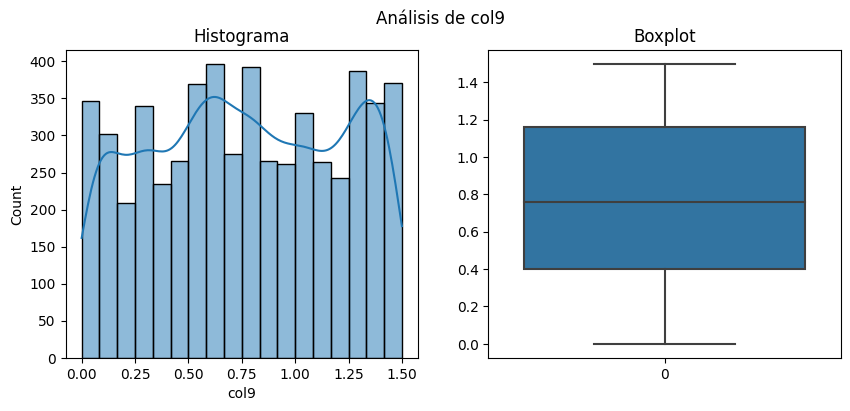

La columna col9 no presenta una distribución normal



Análisis univariante de col10:


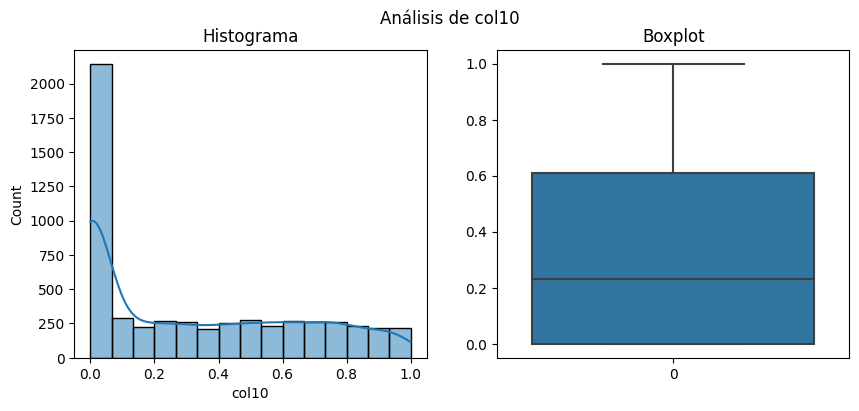

La columna col10 no presenta una distribución normal



Análisis univariante de col11:


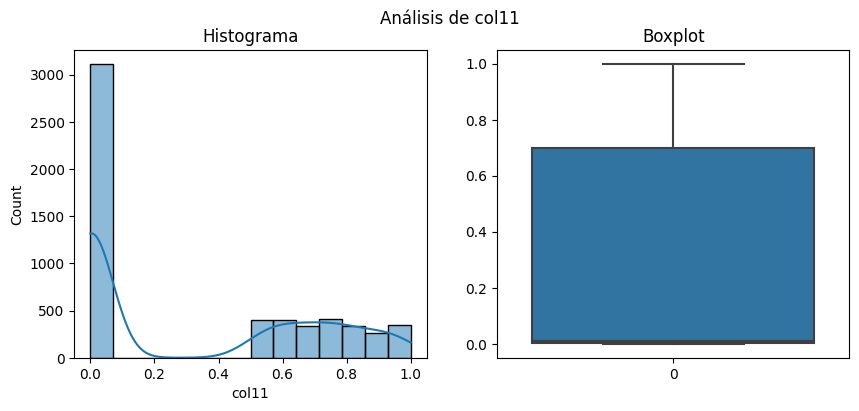

La columna col11 no presenta una distribución normal



Análisis univariante de col12:


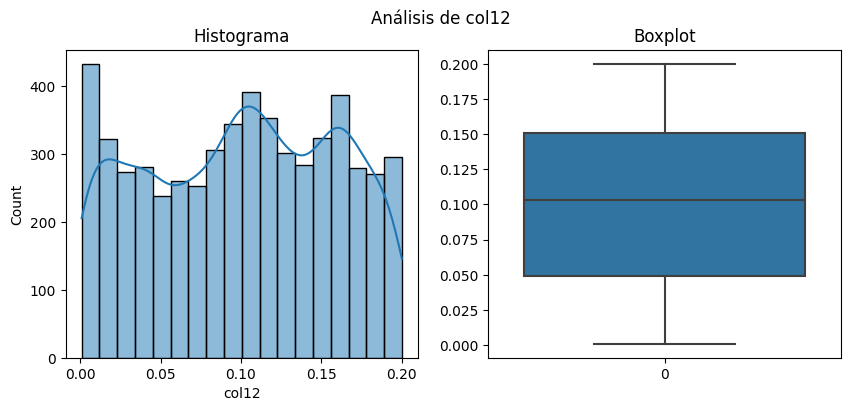

La columna col12 no presenta una distribución normal



Análisis univariante de col13:


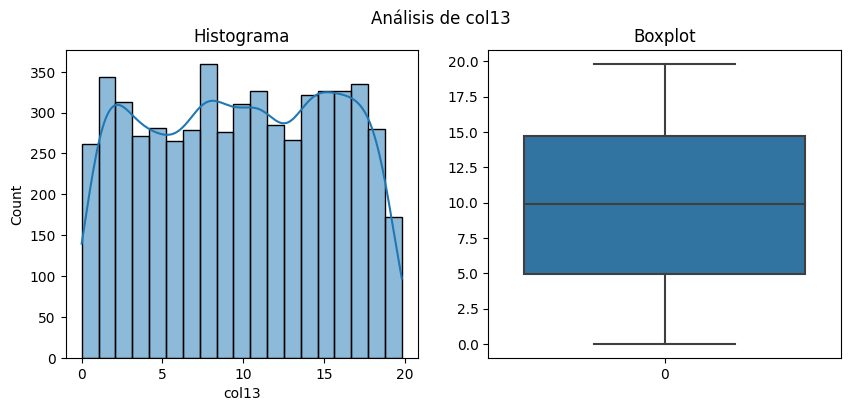

La columna col13 no presenta una distribución normal



Análisis univariante de col14:


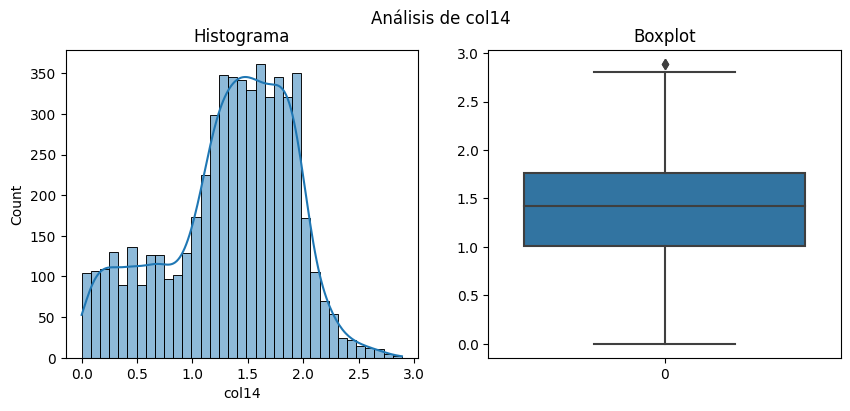

La columna col14 no presenta una distribución normal



Análisis univariante de col15:


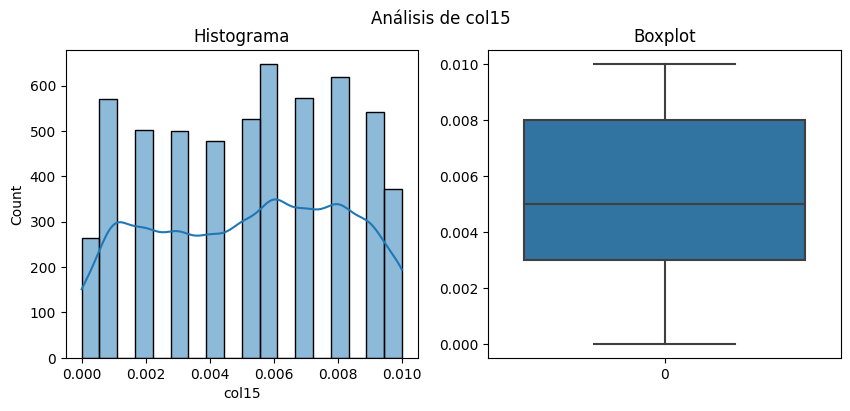

La columna col15 no presenta una distribución normal



Análisis univariante de col16:


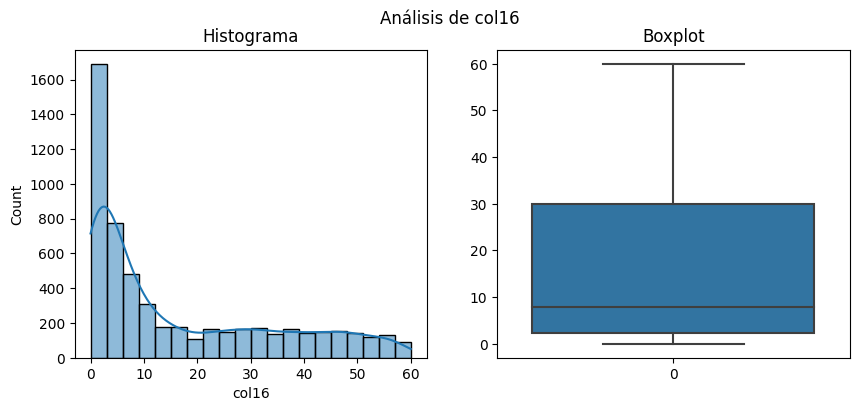

La columna col16 no presenta una distribución normal



Análisis univariante de col17:


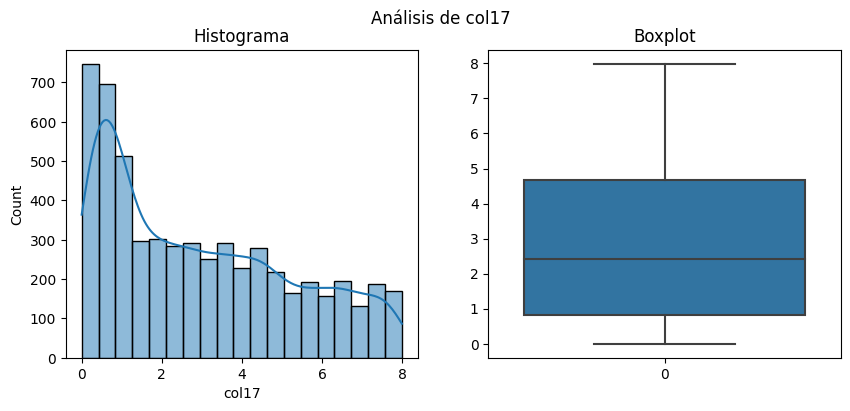

La columna col17 no presenta una distribución normal



Análisis univariante de col18:


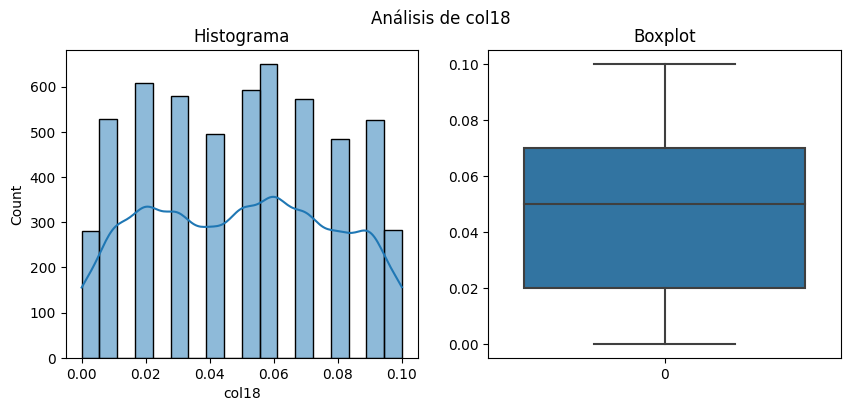

La columna col18 no presenta una distribución normal



Análisis univariante de col19:


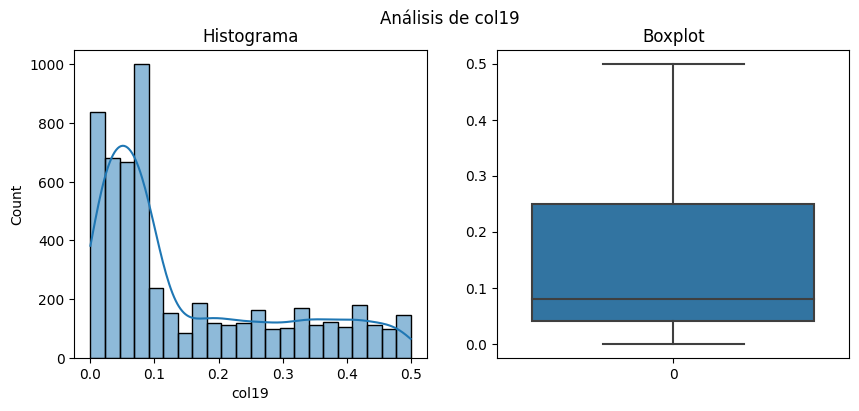

La columna col19 no presenta una distribución normal



Análisis univariante de col20:


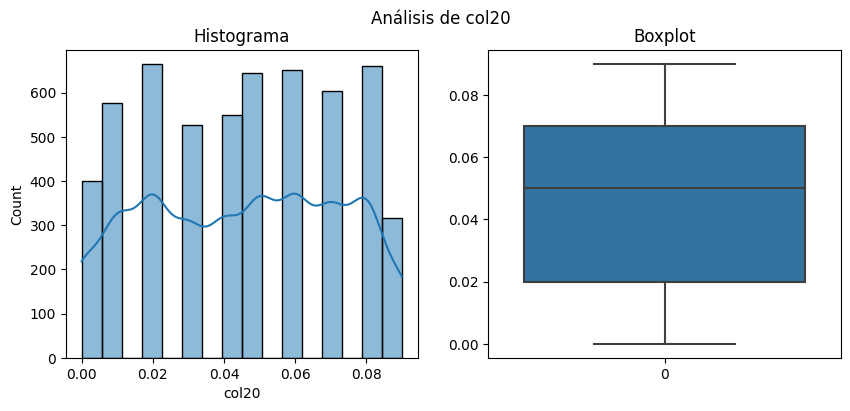

La columna col20 no presenta una distribución normal



Análisis univariante de target:


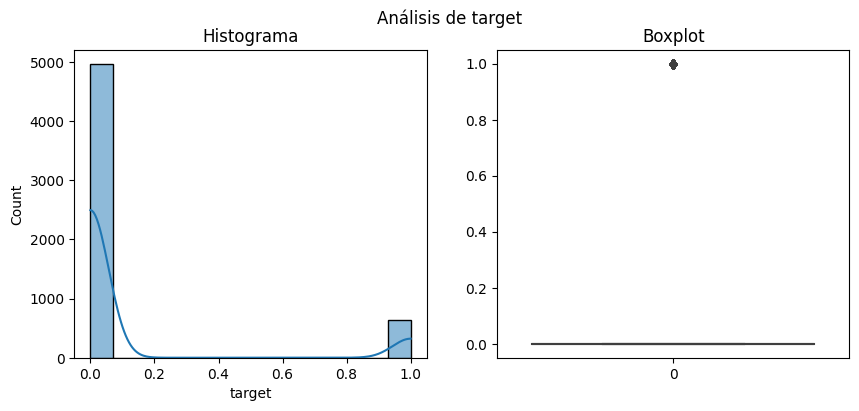

La columna target no presenta una distribución normal



Número de variables que siguen una distribución normal: 0
Número de variables que no siguen una distribución normal: 21


,Media,Mediana,Moda,Varianza,Desviacion_estandar,Percentil_25,Percentil_75,K_test,p_value,Distribución
Municipio,,,,,,,,,,
col1,0.674797,0.070,0.090,1.622253,1.273677,0.040,0.290,0.500000,0.0,No normal
col2,14.438840,14.390,0.370,78.341919,8.851097,6.850,22.260,0.879875,0.0,No normal
col3,0.163603,0.050,0.040,0.064851,0.254659,0.030,0.100,0.500000,0.0,No normal
col4,1.579702,1.210,0.230,1.491378,1.221220,0.550,2.510,0.502676,0.0,No normal
col5,0.042747,0.040,0.060,0.001301,0.036072,0.008,0.070,0.500000,0.0,No normal
col6,2.213093,0.550,0.090,6.662819,2.581244,0.100,4.330,0.500000,0.0,No normal
col7,0.250890,0.090,0.060,0.074241,0.272472,0.050,0.450,0.500000,0.0,No normal
col8,0.807654,0.750,0.050,0.425718,0.652471,0.090,1.390,0.500000,0.0,No normal
col9,0.766057,0.760,1.430,0.190475,0.436435,0.400,1.160,0.500595,0.0,No normal


In [5]:
# Análisis univariante de los datos
fn.get_univariate_analysis(df_train)

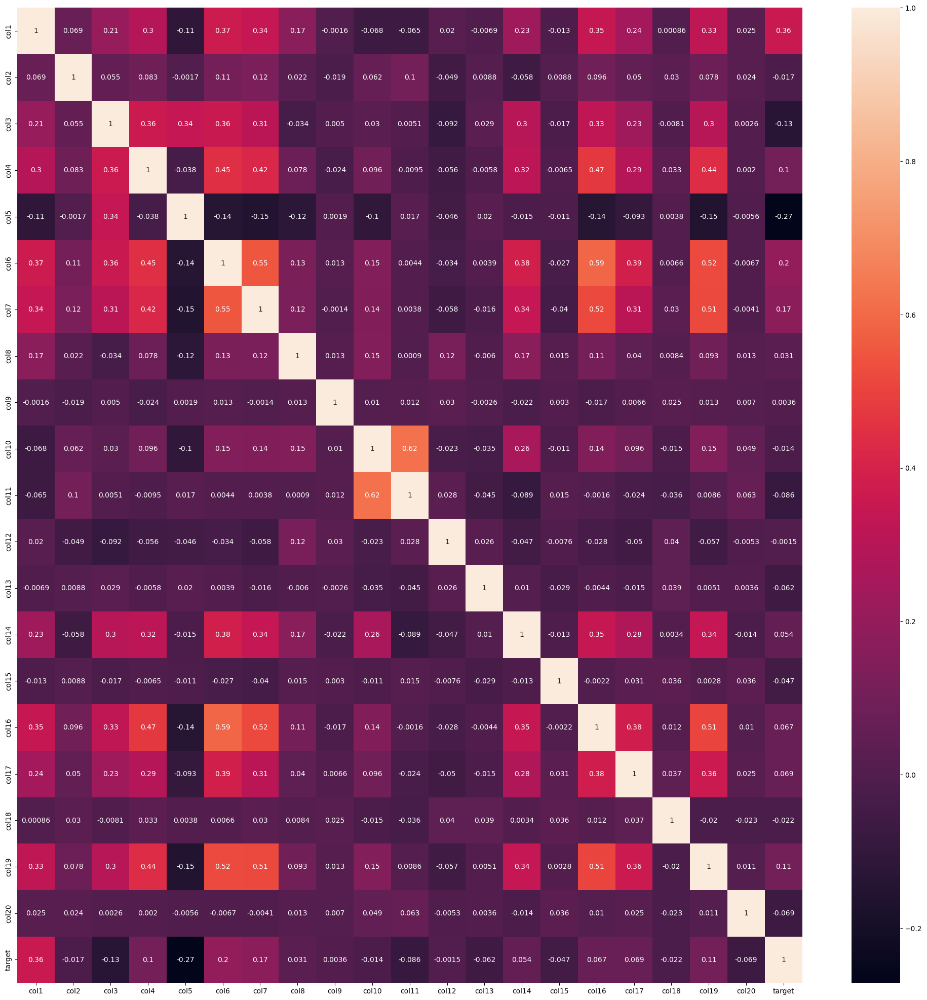

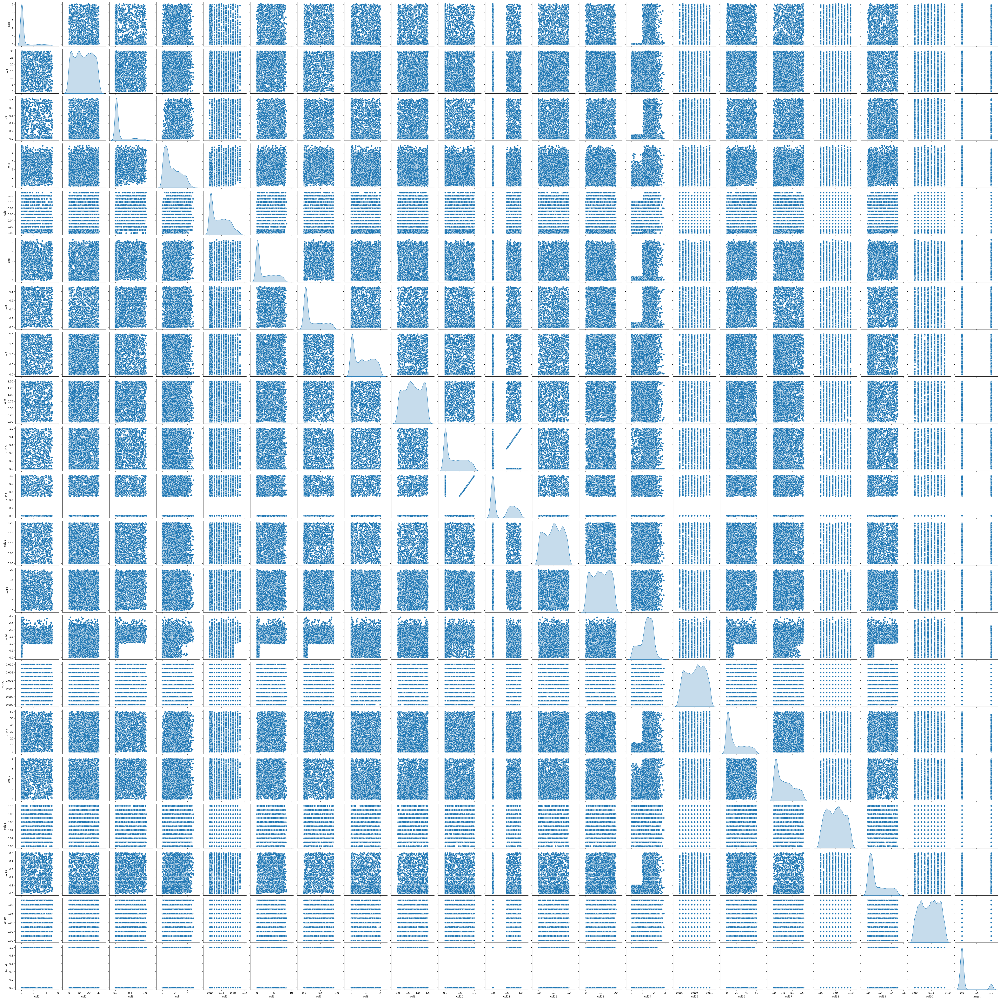

In [6]:
# Análisis bivariante de los datos
fn.get_bivariate_analysis(df_train, annot=True)

In [7]:
# Obtención de outliers
fn.get_outliers(df_train)

[{'col1': 1220,
  'col2': 0,
  'col3': 1154,
  'col4': 0,
  'col5': 0,
  'col6': 0,
  'col7': 0,
  'col8': 0,
  'col9': 0,
  'col10': 0,
  'col11': 0,
  'col12': 0,
  'col13': 0,
  'col14': 2,
  'col15': 0,
  'col16': 0,
  'col17': 0,
  'col18': 0,
  'col19': 0,
  'col20': 0,
  'target': 640},
 {'col1': [1.13,
   0.94,
   4.3,
   3.44,
   4.55,
   1.06,
   2.21,
   3.31,
   4.79,
   1.55,
   4.84,
   4.53,
   3.52,
   1.98,
   4.07,
   3.68,
   1.17,
   1.0,
   2.04,
   1.99,
   0.8,
   4.88,
   4.23,
   2.32,
   4.37,
   4.13,
   4.39,
   4.55,
   3.62,
   2.74,
   1.5,
   4.33,
   3.37,
   3.86,
   4.67,
   3.01,
   3.92,
   1.84,
   4.69,
   1.54,
   3.52,
   0.79,
   2.78,
   2.56,
   1.45,
   2.6,
   1.48,
   3.6,
   1.28,
   2.91,
   4.4,
   3.39,
   1.8,
   0.92,
   4.38,
   2.74,
   1.66,
   1.49,
   2.08,
   1.07,
   2.99,
   1.37,
   5.03,
   4.39,
   2.91,
   4.85,
   3.54,
   3.13,
   3.24,
   4.82,
   3.89,
   2.38,
   3.18,
   1.27,
   2.69,
   2.04,
   0.81,
   4.29,
   

In [8]:
# Observación de valores únicos de la columna target
df_train['target'].value_counts()

0    4957
1     640
Name: target, dtype: int64

Se observa que **ninguna** de las columnas tiene **valores nulos**. Los datos de **todas** las columnas son de tipo **float**. Además, **ninguna** de las columnas tiene los **datos normalizados**. Las columnas **col1**, **col3** y **col14** son las únicas que **contienen outliers**, aunque no son aparentemente anómalos. La única **correlación** destacable a tener en cuenta es la que podría existir entre las columnas **col10 y col11**, donde se puede observar una posible **correlación lineal**.  
  
Por otro lado, la columna target es binaria, por lo que los modelos de machine learning a probar posteriormente serán **modelos categóricos**. Se observa que el **target** está muy **desbalanceado**, por lo que habrá que tenerlo en cuenta posteriormente.

## 1.2 Test

El análisis exploratorio del datasat **test** se realiza de forma más escueta debido a que no se modificará nada de este dataset Únicamente se observará que los datos que contenemos en el son de tipo numérico, que no contiene valores nulos y que tiene el mismo número de columnas que el dataset **train**.

In [9]:
df_test = pd.read_csv('data/test.csv', index_col=0)
df_test.head()

,col1,col2,col3,col4,col5,col6,col7,col8,col9,col10,col11,col12,col13,col14,col15,col16,col17,col18,col19,col20
ID,,,,,,,,,,,,,,,,,,,,
2816,0.06,25.18,0.04,0.04,0.001,5.10,0.86,1.23,0.52,0.62,0.620,0.022,12.63,1.93,0.003,1.19,7.79,0.04,0.43,0.01
3641,0.09,27.51,0.63,2.05,0.110,6.81,0.83,0.09,1.21,0.73,0.730,0.001,4.49,1.95,0.009,52.30,1.00,0.10,0.12,0.01
7191,0.09,1.10,0.07,0.73,0.050,0.10,0.01,1.44,1.42,0.31,0.007,0.177,1.03,1.27,0.002,7.04,0.38,0.06,0.05,0.06
5199,0.07,11.23,0.04,1.22,0.030,0.16,0.03,1.18,0.88,0.00,0.001,0.032,4.07,0.98,0.003,1.28,0.51,0.06,0.03,0.07
7994,0.01,10.00,0.01,2.00,0.000,2.00,0.00,0.09,0.00,0.00,0.000,0.000,0.00,0.00,0.000,0.00,0.00,0.00,0.00,0.00


In [10]:
# Primera visión de los datos
df_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2399 entries, 2816 to 682
Data columns (total 20 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   col1    2399 non-null   float64
 1   col2    2399 non-null   float64
 2   col3    2399 non-null   float64
 3   col4    2399 non-null   float64
 4   col5    2399 non-null   float64
 5   col6    2399 non-null   float64
 6   col7    2399 non-null   float64
 7   col8    2399 non-null   float64
 8   col9    2399 non-null   float64
 9   col10   2399 non-null   float64
 10  col11   2399 non-null   float64
 11  col12   2399 non-null   float64
 12  col13   2399 non-null   float64
 13  col14   2399 non-null   float64
 14  col15   2399 non-null   float64
 15  col16   2399 non-null   float64
 16  col17   2399 non-null   float64
 17  col18   2399 non-null   float64
 18  col19   2399 non-null   float64
 19  col20   2399 non-null   float64
dtypes: float64(20)
memory usage: 393.6 KB


In [11]:
# Primera descripción de los datos
df_test.describe()

,col1,col2,col3,col4,col5,col6,col7,col8,col9,col10,col11,col12,col13,col14,col15,col16,col17,col18,col19,col20
count,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000,2399.000000
mean,0.646794,13.903456,0.156517,1.540459,0.042934,2.094756,0.238925,0.801942,0.784685,0.308991,0.326404,0.097986,9.819208,1.325102,0.005188,16.101351,2.892601,0.049875,0.143043,0.043910
std,1.245658,8.934156,0.247822,1.204305,0.036003,2.532764,0.266264,0.656328,0.432865,0.330579,0.379951,0.058554,5.449099,0.583812,0.002984,17.591092,2.312425,0.028652,0.142070,0.026843
min,0.000000,-0.080000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.040000,6.155000,0.020000,0.560000,0.008000,0.090000,0.040000,0.090000,0.430000,0.000000,0.002000,0.046000,5.240000,0.990000,0.003000,2.110000,0.800000,0.030000,0.040000,0.020000
50%,0.070000,13.640000,0.050000,1.170000,0.040000,0.490000,0.090000,0.750000,0.790000,0.190000,0.008000,0.100000,10.130000,1.420000,0.005000,7.480000,2.390000,0.050000,0.080000,0.040000
75%,0.245000,21.820000,0.100000,2.420000,0.070000,4.045000,0.410000,1.380000,1.160000,0.610000,0.710000,0.150000,14.350000,1.760000,0.008000,28.430000,4.665000,0.070000,0.230000,0.070000
max,5.030000,29.840000,1.050000,4.870000,0.130000,8.680000,0.900000,2.000000,1.500000,1.000000,1.000000,0.200000,19.830000,2.930000,0.010000,59.740000,7.970000,0.100000,0.500000,0.090000


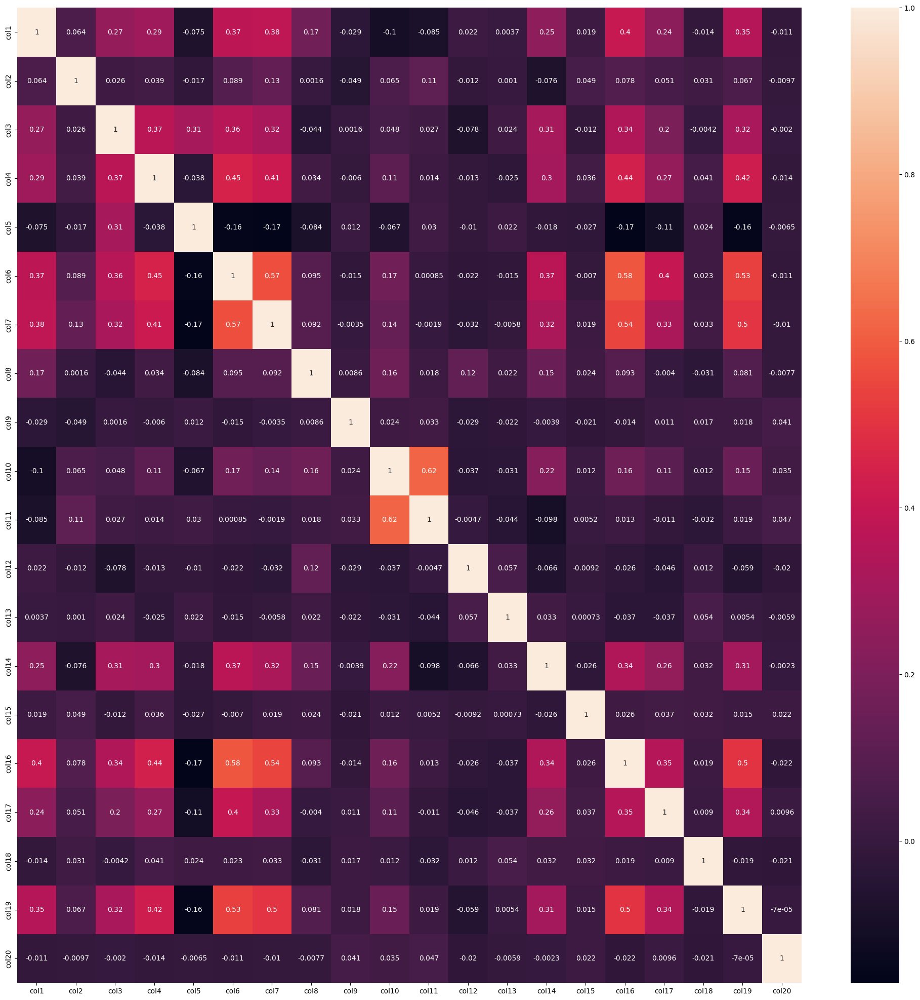

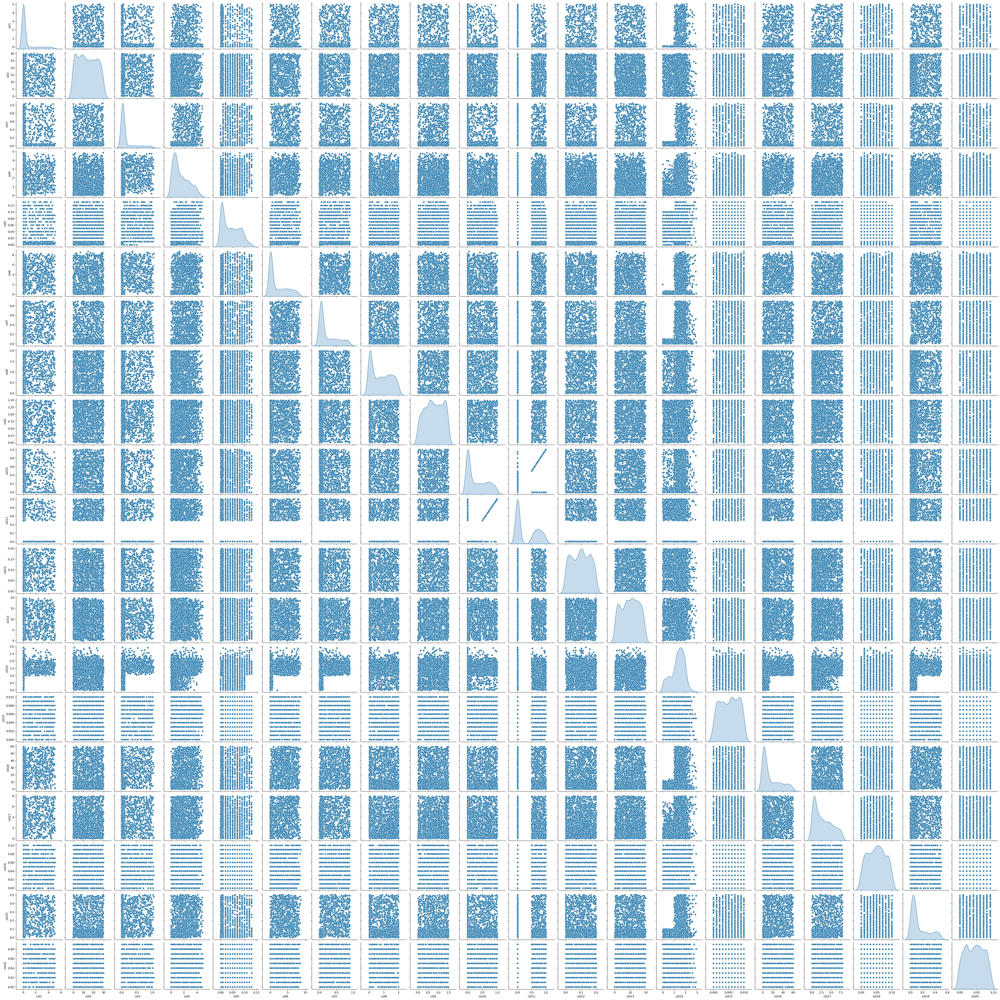

In [12]:
# Análisis bivariante de los datos
fn.get_bivariate_analysis(df_test, annot=True)

In [13]:
# Obtención de outliers
fn.get_outliers(df_test)

[{'col1': 510,
  'col2': 0,
  'col3': 468,
  'col4': 0,
  'col5': 0,
  'col6': 0,
  'col7': 0,
  'col8': 0,
  'col9': 0,
  'col10': 0,
  'col11': 0,
  'col12': 0,
  'col13': 0,
  'col14': 2,
  'col15': 0,
  'col16': 0,
  'col17': 0,
  'col18': 0,
  'col19': 0,
  'col20': 0},
 {'col1': [0.83,
   1.34,
   0.96,
   3.88,
   1.79,
   4.43,
   0.6,
   3.84,
   1.21,
   3.02,
   3.08,
   4.57,
   3.05,
   3.55,
   3.98,
   4.67,
   2.58,
   1.14,
   1.53,
   2.71,
   2.58,
   2.11,
   4.1,
   0.67,
   4.35,
   4.84,
   2.33,
   3.88,
   3.75,
   2.52,
   4.1,
   0.58,
   3.82,
   4.69,
   4.15,
   2.29,
   3.98,
   3.75,
   2.51,
   1.01,
   1.59,
   3.34,
   2.41,
   4.05,
   1.19,
   3.39,
   4.35,
   2.03,
   2.27,
   1.21,
   2.45,
   2.66,
   0.9,
   3.57,
   3.48,
   2.03,
   3.86,
   1.6,
   3.51,
   4.13,
   4.55,
   2.11,
   2.02,
   3.73,
   3.89,
   4.15,
   1.81,
   3.18,
   4.61,
   4.52,
   3.04,
   4.35,
   3.57,
   1.75,
   4.32,
   4.78,
   4.42,
   4.54,
   4.07,
   1.91,
 

Se observan que los datos datos del dataset **test** tienen las mismas variables que el dataset **train**. Los datos de este dataset son de **tipo float** y las **distribuciones** son **similares** a las del dataset train. 

# 2. Preprocesamiento de datos  
  
Al no obtener ninguna columna de tipo object, no tener nungún dato anomalo y al no tener valores nulos, no se modificará nada del dataset inicialmente. Tras obtener el mejor modelo posible de machine learning se probará a eliminar la columna 10 u 11 para ver si mejora el modelo. También se realizará una estandarización de los datos, aunque eso lo incluiremos dentro del apartado de selección de modelo. Finalmente, el balanceado también se realizará tras obtener el mejor modelo de machine learning para intentar mejorarlo.

# 3. Creación de un modelo de línea base (Baseline)  
  
Se crearán todos los modelos de machine learning categóricos adecuados para comprobar posteriormente cual es el más adecuado para estos datos. Previamente al entrenado del modelo se realizará una estandarización de los datos.


In [16]:
# Modelo logística lineal
logistic_pipeline = Pipeline(
    [("Escalado", StandardScaler()),
    ("Modelo", LogisticRegression())
    ])

# Modelo Ramdon Forest
random_pipeline = Pipeline(
    [("Escalado", StandardScaler()),
    ("Modelo", RandomForestClassifier())
    ])

# Modelo KNN
knn_pipeline = Pipeline(
    [("Escalado", StandardScaler()),
    ("Modelo", KNeighborsClassifier())
    ])

# Modelo SVM
svm_pipeline = Pipeline(
    [("Escalado", StandardScaler()),
    ("Modelo", SVC())
    ])


# 4. Evaluación del modelo  
  
Se realizará una evaluación de los diferentes modelos para obtener cual de ellos es el más adecuado para este dataset. Como métrica se utilizara la precisión del modelo.

In [25]:
for name,pipe in zip(["logistic","randomF", "KNN", "SVM"],[logistic_pipeline, random_pipeline, knn_pipeline, svm_pipeline]):
    resultado = cross_val_score(pipe, df_train.drop(["target"], axis=1), df_train['target'], cv = 5, scoring = 'accuracy')
    print(f"{name}: {np.mean(resultado):.4f}")
    print(resultado)

logistic: 0.8675
[0.8801427  0.86436019 0.87124748 0.8494655  0.87243788]
randomF: 0.9710
[0.9798584  0.97165212 0.97057896 0.95886021 0.97381906]
KNN: 0.8625
[0.87957173 0.89113297 0.8360794  0.85475136 0.85101066]
SVM: 0.9504
[0.96137853 0.95833071 0.94975088 0.93889537 0.94359391]


# 5. Selección del modelo  
  
El modelo seleccionado para seguir la evaluación es el modelo **Random Forest**. Lo seleccionamos porque, tras realizar una validación cruzada dividiendo el dataset en 5, la media de las 5 precisiones obtenidas es más alta en el método Ramdon Forest.

# 6. Mejora del modelo  
  
Intentamos mejorar el modelo obtenido lo máximo posible.  
  
## 6.1. Balanceado
  
Primero, se intentará balancear el dataframe. Como no existen tantas observaciones, lo que se hará es copiar las observaciones cuyo valor en el target es 1 hasta que tengan el mismo número de 0 que de 1. y se comprovará el resultado.

In [47]:
# Balanceado
ratio = len(df_train[df_train["target"] == 0])/len(df_train[df_train["target"] == 1])

df_copy = df_train.loc[df_train[df_train["target"] == 1].index.repeat(ratio)].copy()

df_copy.index = df_train.index.max() + 1 + df_copy.groupby(level=0).cumcount()

df_train = pd.concat([df_train, df_copy])

df_train["target"].value_counts()


1    5120
0    4957
Name: target, dtype: int64

In [48]:
random_bal = RandomForestClassifier()
resultado = cross_val_score(random_bal, df_train.drop(["target"], axis=1), df_train['target'], cv = 5, scoring = 'accuracy')
print(f"Ramdon Forest: {np.mean(resultado):.4f}")
print(resultado)

Ramdon Forest: 0.9796
[0.93204365 0.99206349 0.99454094 0.991067   0.98808933]


Se ha mejorado la precisión, por lo que mantendremos el cambio.  
  
## 6.2 Eliminación de correlaciones  
  
Procederemos a comprobar cual de las dos columnas que tienen una correlación, **col10** y **col11** tienen mayor peso en el modelo, auqella que tenga menor peso será eliminada. Finalmente, se procede a comprobar la precisión del nuevo modelo.

In [49]:
# Se crea un modelo nuevo y se entrena para comprobar el peso de los parámetros.

random_parametros = RandomForestClassifier()
random_parametros.fit(df_train.drop(["target"], axis=1), df_train['target'])
df_ft = pd.DataFrame({'features':df_train.drop(["target"], axis=1).columns, 'importances':random_parametros.feature_importances_}).sort_values('importances', ascending=False)
df_ft

,features,importances
0,col1,0.194139
4,col5,0.149233
15,col16,0.075721
2,col3,0.066386
5,col6,0.063212
18,col19,0.062024
6,col7,0.043279
19,col20,0.040749
10,col11,0.040612
13,col14,0.040300


In [50]:
# Se elimina la columna 10 y se comprueba si mejora el modelo
df_train_sin10 = df_train.drop(["col10"], axis=1)

df_train_sin10.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10077 entries, 4995 to 8000
Data columns (total 20 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   col1    10077 non-null  float64
 1   col2    10077 non-null  float64
 2   col3    10077 non-null  float64
 3   col4    10077 non-null  float64
 4   col5    10077 non-null  float64
 5   col6    10077 non-null  float64
 6   col7    10077 non-null  float64
 7   col8    10077 non-null  float64
 8   col9    10077 non-null  float64
 9   col11   10077 non-null  float64
 10  col12   10077 non-null  float64
 11  col13   10077 non-null  float64
 12  col14   10077 non-null  float64
 13  col15   10077 non-null  float64
 14  col16   10077 non-null  float64
 15  col17   10077 non-null  float64
 16  col18   10077 non-null  float64
 17  col19   10077 non-null  float64
 18  col20   10077 non-null  float64
 19  target  10077 non-null  int64  
dtypes: float64(19), int64(1)
memory usage: 1.6 MB


In [51]:
random_corr = RandomForestClassifier()

resultado = cross_val_score(random_corr, df_train_sin10.drop(["target"], axis=1), df_train['target'], cv = 5, scoring = 'accuracy')
print(f"Ramdon Forest: {np.mean(resultado):.4f}")
print(resultado)

Ramdon Forest: 0.9794
[0.93253968 0.99156746 0.99404467 0.991067   0.98759305]


El modelo ha empeorado, por lo que probamos a eliminar la columna 11 por si, aunque tenga más importancia en el modelo, este por casualidad mejorara.

In [54]:
# Se elimina la columna 11 y se comprueba si mejora el modelo
df_train_sin11 = df_train.drop(["col11"], axis=1)

df_train_sin11.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10077 entries, 4995 to 8000
Data columns (total 20 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   col1    10077 non-null  float64
 1   col2    10077 non-null  float64
 2   col3    10077 non-null  float64
 3   col4    10077 non-null  float64
 4   col5    10077 non-null  float64
 5   col6    10077 non-null  float64
 6   col7    10077 non-null  float64
 7   col8    10077 non-null  float64
 8   col9    10077 non-null  float64
 9   col10   10077 non-null  float64
 10  col12   10077 non-null  float64
 11  col13   10077 non-null  float64
 12  col14   10077 non-null  float64
 13  col15   10077 non-null  float64
 14  col16   10077 non-null  float64
 15  col17   10077 non-null  float64
 16  col18   10077 non-null  float64
 17  col19   10077 non-null  float64
 18  col20   10077 non-null  float64
 19  target  10077 non-null  int64  
dtypes: float64(19), int64(1)
memory usage: 1.6 MB


In [55]:
random_corr = RandomForestClassifier()

resultado = cross_val_score(random_corr, df_train_sin11.drop(["target"], axis=1), df_train['target'], cv = 5, scoring = 'accuracy')
print(f"Ramdon Forest: {np.mean(resultado):.4f}")
print(resultado)

Ramdon Forest: 0.9797
[0.93253968 0.99156746 0.99354839 0.991067   0.98957816]


Observamos que si que ha mejorado en este caso un poco el modelo, por lo que mantenemos el cambio de eliminar la columna 11.

In [56]:
df_train = df_train_sin11

df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10077 entries, 4995 to 8000
Data columns (total 20 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   col1    10077 non-null  float64
 1   col2    10077 non-null  float64
 2   col3    10077 non-null  float64
 3   col4    10077 non-null  float64
 4   col5    10077 non-null  float64
 5   col6    10077 non-null  float64
 6   col7    10077 non-null  float64
 7   col8    10077 non-null  float64
 8   col9    10077 non-null  float64
 9   col10   10077 non-null  float64
 10  col12   10077 non-null  float64
 11  col13   10077 non-null  float64
 12  col14   10077 non-null  float64
 13  col15   10077 non-null  float64
 14  col16   10077 non-null  float64
 15  col17   10077 non-null  float64
 16  col18   10077 non-null  float64
 17  col19   10077 non-null  float64
 18  col20   10077 non-null  float64
 19  target  10077 non-null  int64  
dtypes: float64(19), int64(1)
memory usage: 1.6 MB


Eliminamos la misma columna en el test

In [70]:
# Se elimina la columna 11
df_test= df_test.drop(["col11"], axis=1)

df_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2399 entries, 2816 to 682
Data columns (total 19 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   col1    2399 non-null   float64
 1   col2    2399 non-null   float64
 2   col3    2399 non-null   float64
 3   col4    2399 non-null   float64
 4   col5    2399 non-null   float64
 5   col6    2399 non-null   float64
 6   col7    2399 non-null   float64
 7   col8    2399 non-null   float64
 8   col9    2399 non-null   float64
 9   col10   2399 non-null   float64
 10  col12   2399 non-null   float64
 11  col13   2399 non-null   float64
 12  col14   2399 non-null   float64
 13  col15   2399 non-null   float64
 14  col16   2399 non-null   float64
 15  col17   2399 non-null   float64
 16  col18   2399 non-null   float64
 17  col19   2399 non-null   float64
 18  col20   2399 non-null   float64
dtypes: float64(19)
memory usage: 439.4 KB


## 6.3 Hiperparámetros  
  
Procedemos a observar que hiperparámetros son los que proporcionan un mejor modelo.

In [65]:
# Hiperparámetros a observar
pipe_rand_forest_param = {
    'n_estimators': [10, 100, 200, 400],
    'max_depth': [1,2,4,8],
    'max_features': [1, 2, 3],
    "class_weight": ['balanced', None]
    }

# Número de pliegues para la validación cruzada
cv = 5 

# Comprobamos los hiperparámetros
random_gs = RandomForestClassifier()
gs_rand_forest = GridSearchCV(random_gs,
                            pipe_rand_forest_param,
                            cv=cv,
                            scoring='accuracy',
                            verbose=1,
                            n_jobs=-1)

gs_rand_forest.fit(df_train.drop(["target"], axis=1), df_train['target'])

Fitting 5 folds for each of 96 candidates, totalling 480 fits


GridSearchCV(cv=5, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'class_weight': ['balanced', None],
                         'max_depth': [1, 2, 4, 8], 'max_features': [1, 2, 3],
                         'n_estimators': [10, 100, 200, 400]},
             scoring='accuracy', verbose=1)

In [66]:
gs_rand_forest.best_params_

{'class_weight': 'balanced',
 'max_depth': 8,
 'max_features': 3,
 'n_estimators': 200}

Mantenemos estos hiperparámetros para realizar la predicción del test.

# 7. Predicción  
  
Realizamos la predicción del dataset test y guardamos estos datos en un csv llamado **target_test.csv**. Este archivo será el que se dispondrá para la evaluación. 

In [71]:
# Predicción
predictions_submit = gs_rand_forest.best_estimator_.predict(df_test)
predictions_submit

array([0, 0, 0, ..., 0, 0, 1])

In [72]:
# Creación de un dataset con la predicción
target_test = pd.DataFrame({"id": df_test.index, "target": predictions_submit})
target_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2399 entries, 0 to 2398
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   id      2399 non-null   int64
 1   target  2399 non-null   int64
dtypes: int64(2)
memory usage: 37.6 KB


In [73]:
# Exportación a csv
target_test.to_csv("data/target_test.csv", index=False)